In [3]:
import matplotlib.pyplot as plt
import os

In [ ]:
#clone the github repo for yolov7

%pip install git+https://github.com/WongKinYiu/yolov7

### The dataset was then put into a new folder inside the cloned repository called 'trash-images'

To train the model the below command is then used

In [ ]:
!python train.py --weights yolov7.pt --cfg cfg/training/yolov7.yaml --data data.yaml --epochs 50 --batch-size 8 --device 0

### The model alongside its weights and perfomance are stored in the 'runs' folder, with each new run of the above command creating a new folder with the new trained model

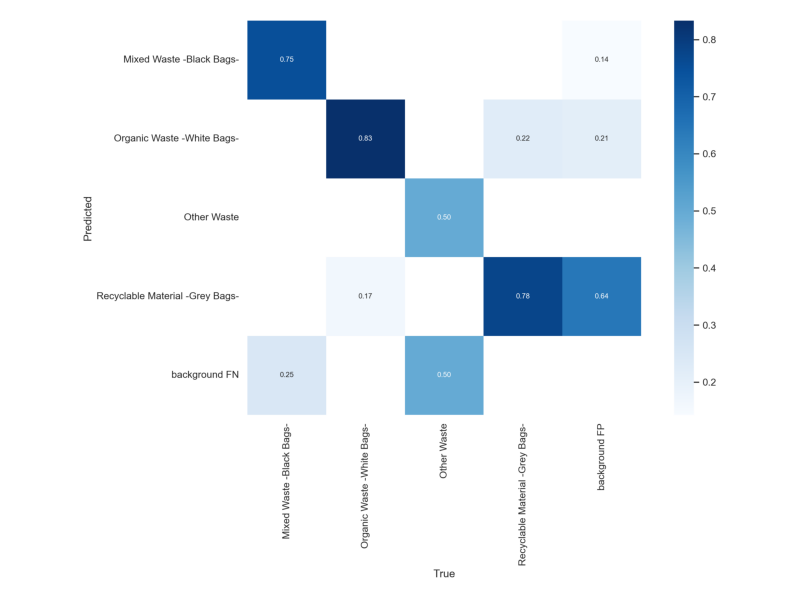

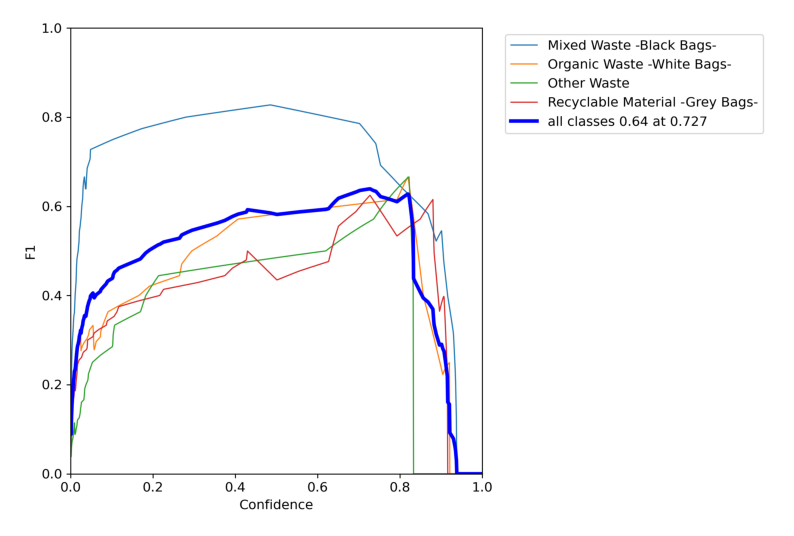

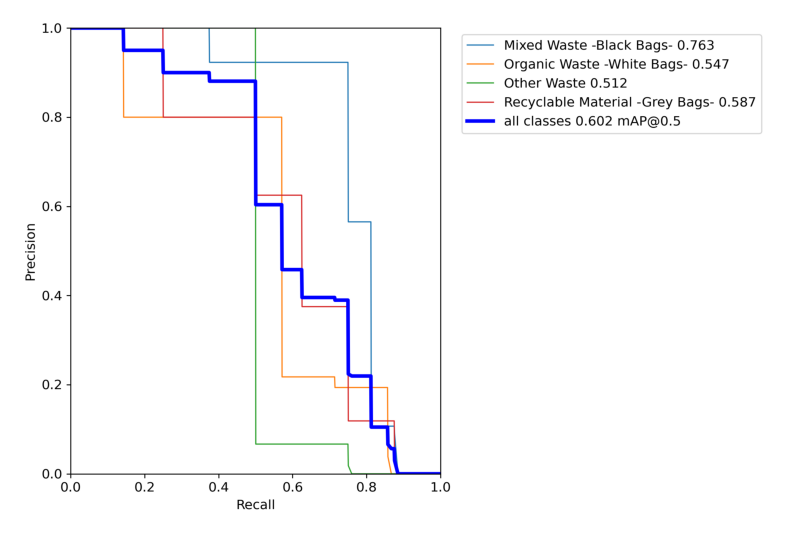

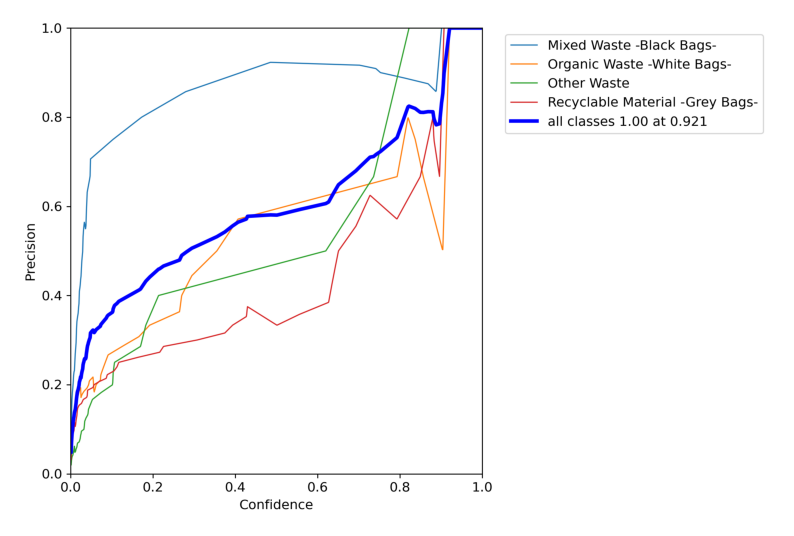

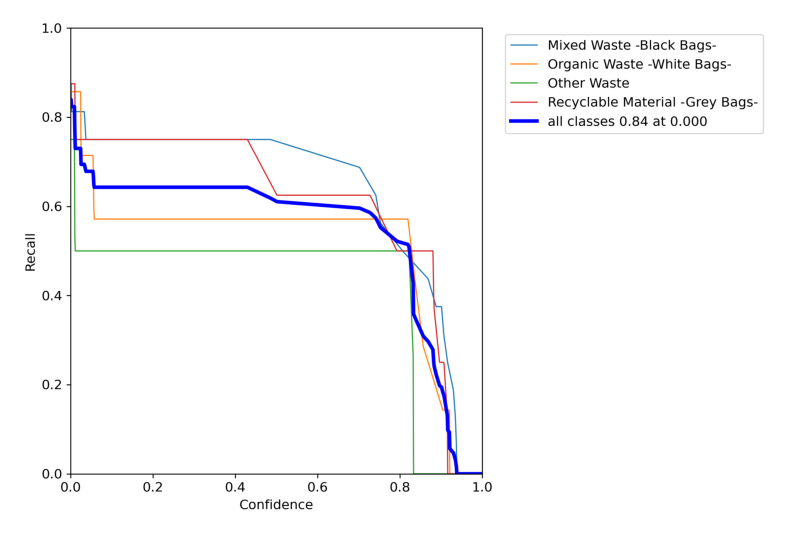

In [4]:
#visualise all the generated performance metrics
test_dir = 'runs/test/exp'
train_dir = 'runs/train/exp'

#open all the png files in the directory
for file in os.listdir(test_dir):
    if file.endswith('.png'):
        img = plt.imread(os.path.join(test_dir, file))
        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        plt.axis('off')
        plt.show()

## Test image detection produced by the model

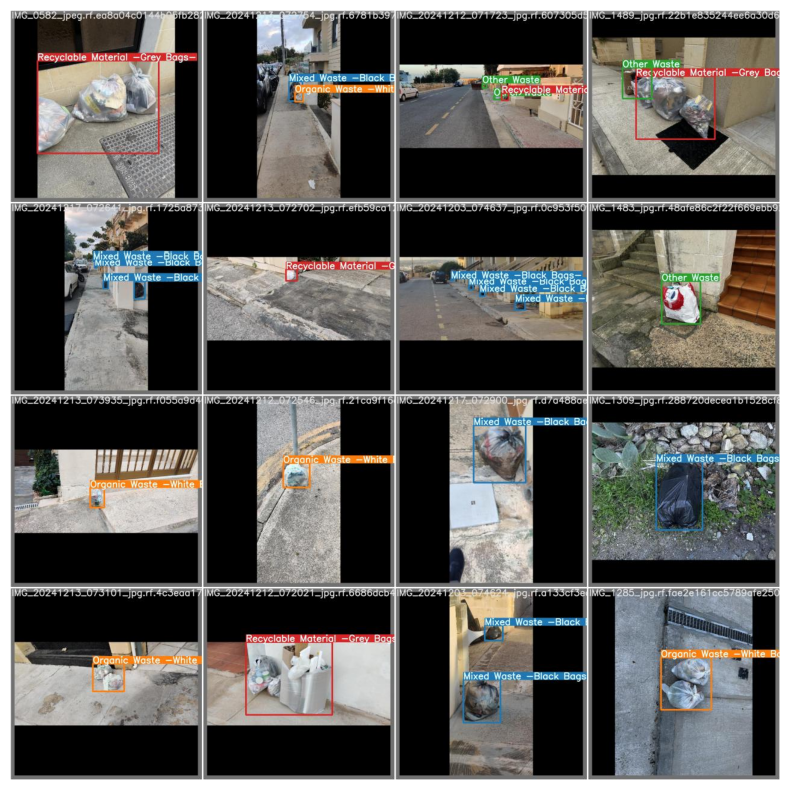

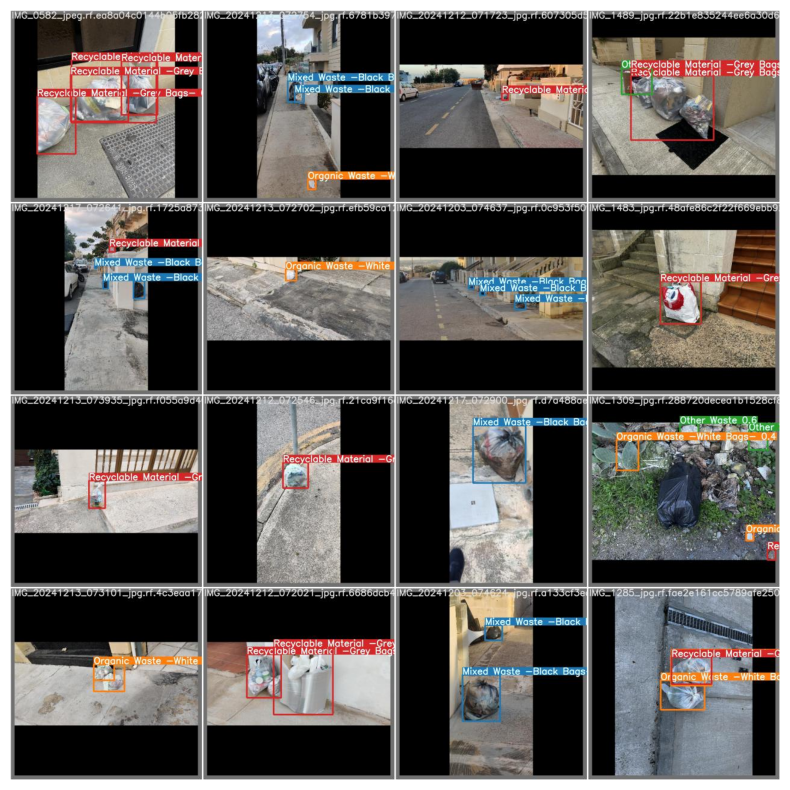

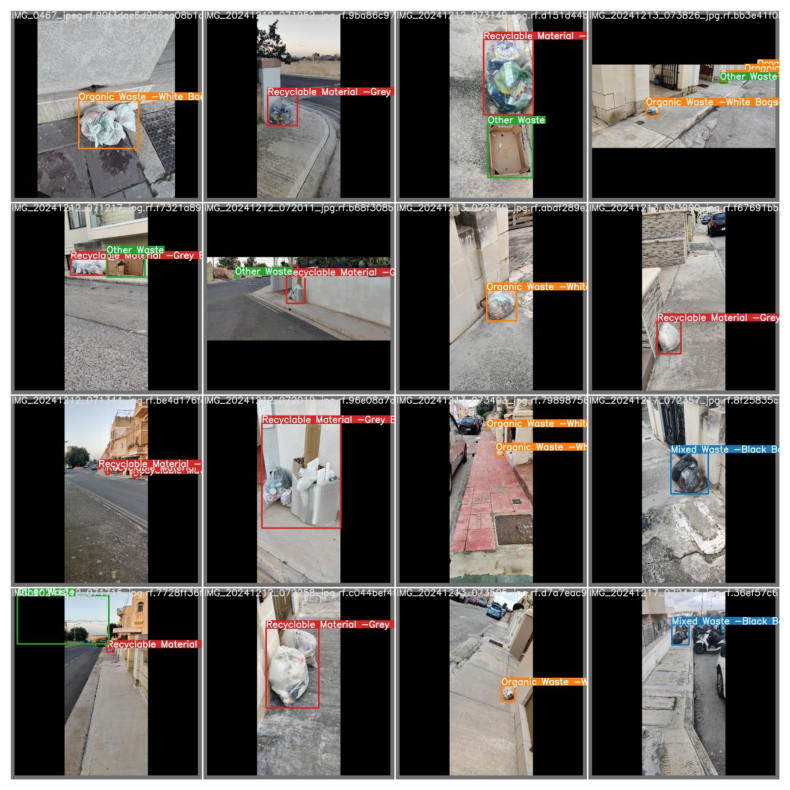

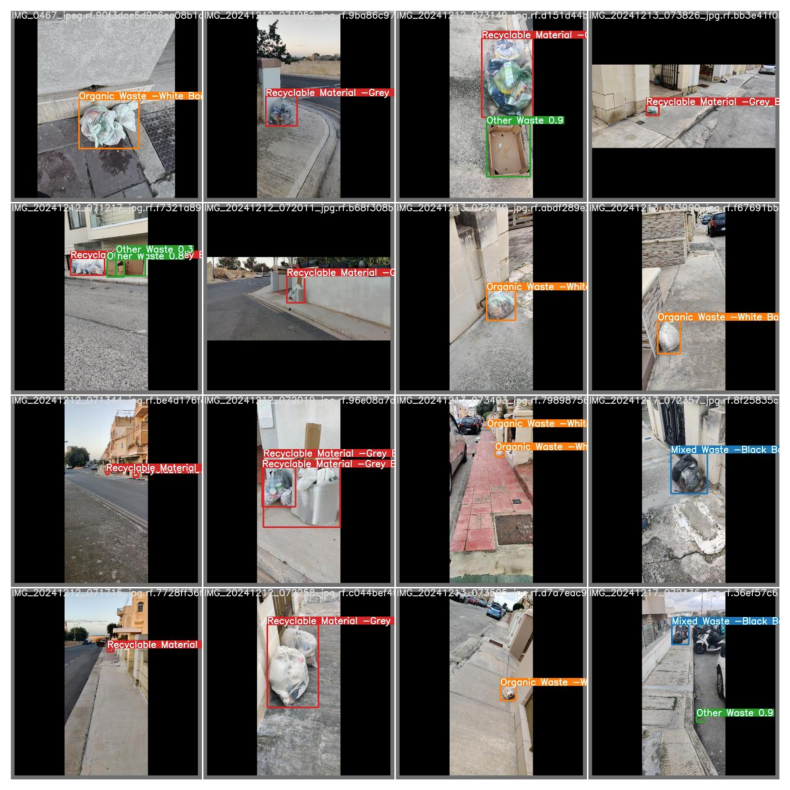

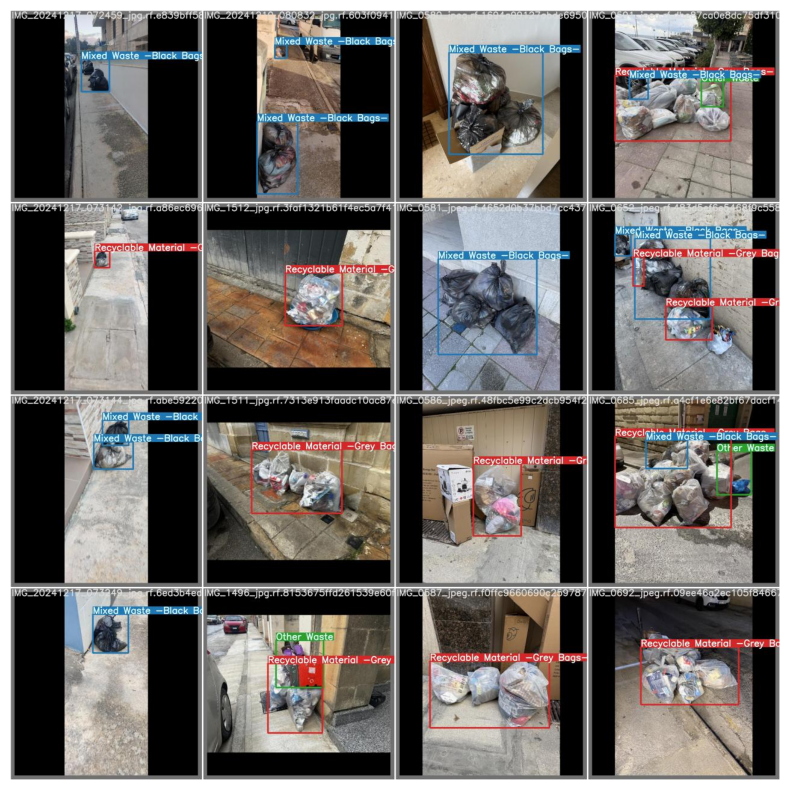

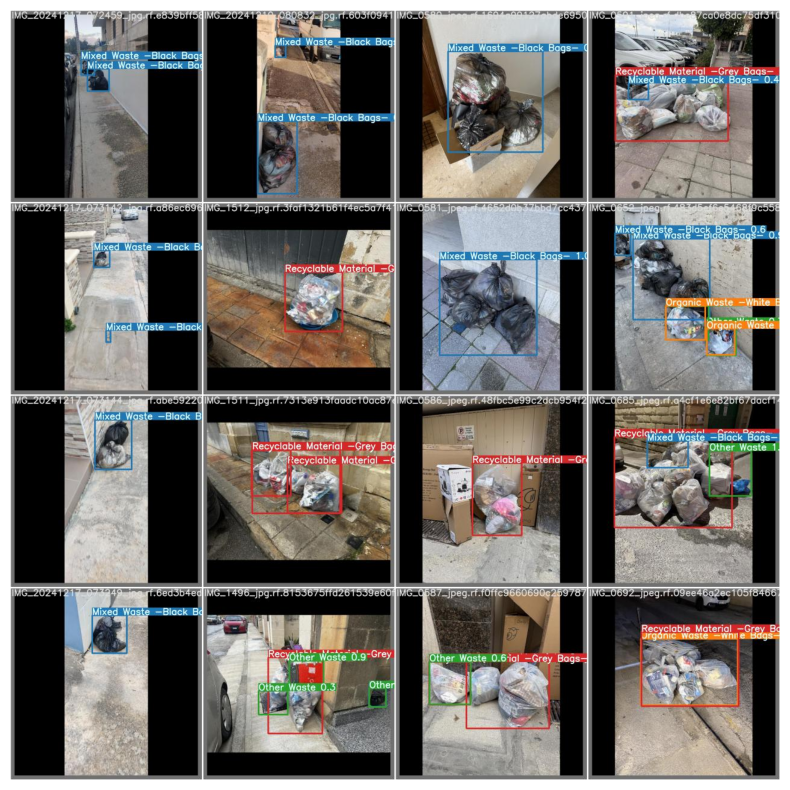

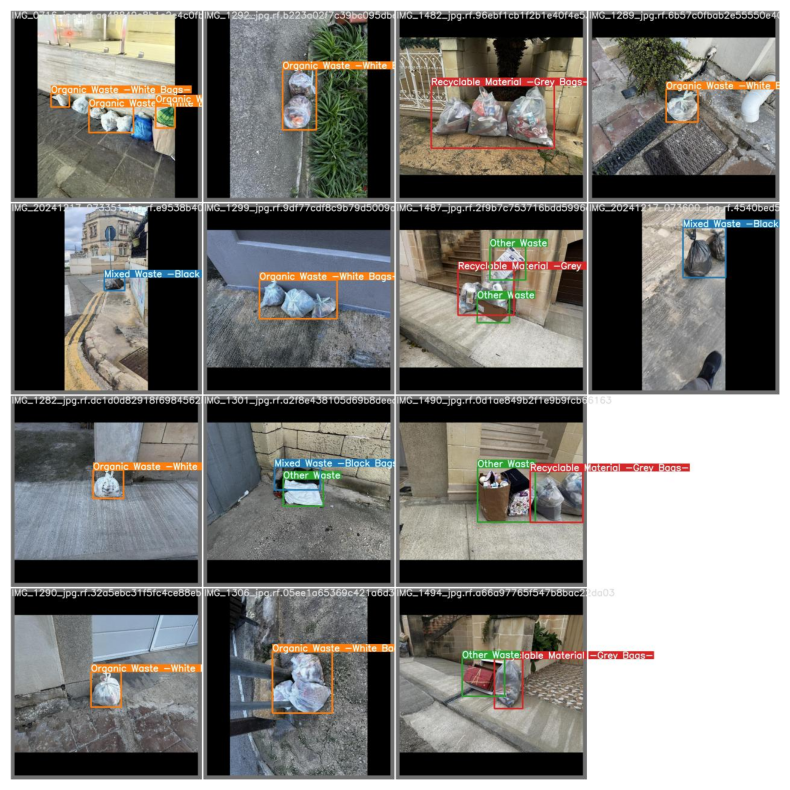

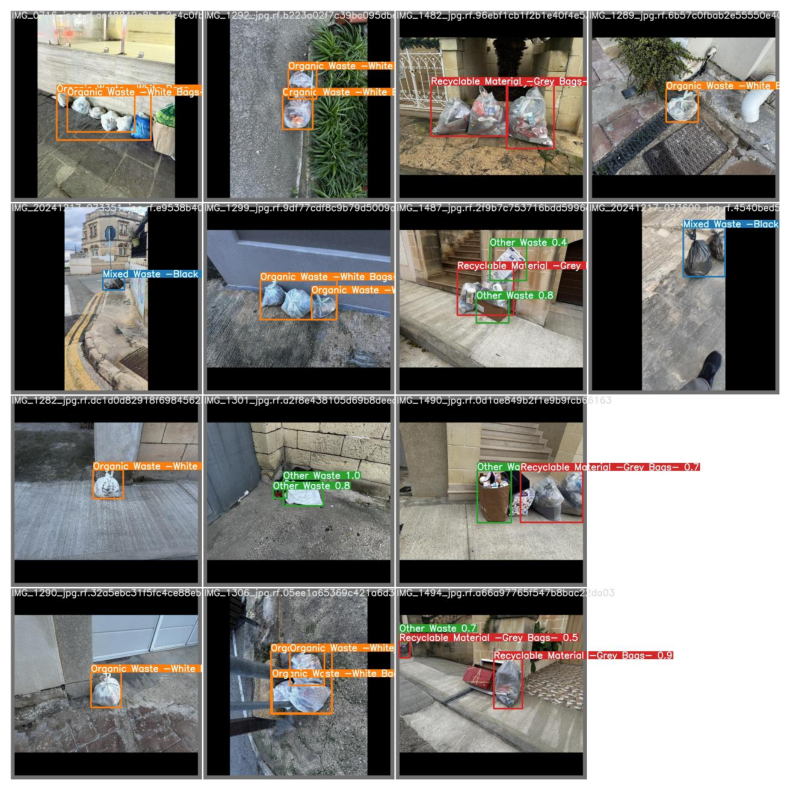

In [12]:
for file in os.listdir(test_dir):
    if file.startswith('test') and file.endswith('.jpg'):
        with open(os.path.join(test_dir, file), 'r') as f:
            img = plt.imread(os.path.join(test_dir, file))
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            plt.axis('off')
            plt.show()
            
for file in os.listdir(train_dir):
    if file.startswith('test') and file.endswith('.jpg'):
        with open(os.path.join(train_dir, file), 'r') as f:
            img = plt.imread(os.path.join(train_dir, file))
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            plt.axis('off')
            plt.show()

## Precision Recall and mAP@50

In [5]:
results_file = os.path.join(train_dir, "results.txt")


# Define lists to store metrics
precision = []
recall = []
map50 = []

# Parse results.txt
with open(results_file, 'r') as f:
    for line in f:
        
        # split the line into parts
        parts = line.strip().split()
        
        # ensure there are enough columns in the line
        if len(parts) < 12:
            print(f"Skipping malformed line: {line.strip()}")
            continue
        
        try:
            # extract relevant metrics based on the structure of the generatded text file
            precision.append(float(parts[8]))
            recall.append(float(parts[9]))     
            map50.append(float(parts[10]))     
        except ValueError as e:
            print(f"Error parsing line: {line.strip()} - {e}")


if not precision:
    print("No valid metrics found in the results file.")
else:
    print(f"Final Precision: {precision[-1]:.4f}")
    print(f"Final Recall: {recall[-1]:.4f}")
    print(f"Final mAP@50: {map50[-1]:.4f}")

Final Precision: 0.6128
Final Recall: 0.7001
Final mAP@50: 0.6466


## Test run of the model

In [39]:
!python test.py --weights runs/train/exp/weights/best.pt --data data.yaml --iou-thres 0.5 --task test --save-txt --save-conf

Namespace(weights=['runs/train/exp/weights/best.pt'], data='data.yaml', batch_size=32, img_size=640, conf_thres=0.001, iou_thres=0.5, task='test', device='', single_cls=False, augment=False, verbose=False, save_txt=True, save_hybrid=False, save_conf=True, save_json=False, project='runs/test', name='exp', exist_ok=False, no_trace=False, v5_metric=False)
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

                 all          23          35        0.71       0.586       0.602       0.482
Mixed Waste -Black Bags-          23          16       0.912       0.648       0.763       0.538
Organic Waste -White Bags-          23           7        0.65       0.571       0.547       0.454
         Other Waste          23           4       0.654         0.5       0.512       0.428
Recyclable Material -Grey Bags-          23           8       0.624  

YOLOR  2025-1-19 torch 2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3090, 24575.5MB)

c:\Users\Owner\Desktop\Advanced CV\yolov7\models\experimental.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this e

## Calculating TP FP & FN

In [40]:
def convert_polygon_to_yolo(input_file, output_file):

    output_lines = []

    output_dir = os.path.dirname(output_file)
    os.makedirs(output_dir, exist_ok=True)

    with open(input_file, 'r') as f_in:
        for line in f_in:
            values = line.strip().split()
            class_id = values[0]
            coords = list(map(float, values[1:]))

            if len(coords) % 2 != 0:
                print(f"Skipping malformed line: {line.strip()}")
                continue

            x_coords = coords[::2]
            y_coords = coords[1::2]

            x_min = min(x_coords)
            y_min = min(y_coords)
            x_max = max(x_coords)
            y_max = max(y_coords)

            # convert to YOLO format
            x_center = (x_min + x_max) / 2
            y_center = (y_min + y_max) / 2
            width = x_max - x_min
            height = y_max - y_min

            output_lines.append(f"{class_id} {x_center} {y_center} {width} {height}\n")

    with open(output_file, 'w') as f_out:
        f_out.writelines(output_lines)

    print(f"Conversion complete! Output saved to: {output_file}")

input_dir = "trash-images/test/labels"  
output_dir = "converted_labels/"  

for file in os.listdir(input_dir):
    if file.endswith('.txt'):
        input_file = os.path.join(input_dir, file)
        output_file = os.path.join(output_dir, file)
        convert_polygon_to_yolo(input_file, output_file)
print("All files converted!")

Conversion complete! Output saved to: converted_labels/IMG_0582_jpeg.rf.ea8a04c0144b05fb282a92159acc5c7c.txt
Conversion complete! Output saved to: converted_labels/IMG_0656_jpeg.rf.0e15268f93835603a6a977bf4e9426fb.txt
Conversion complete! Output saved to: converted_labels/IMG_0694_jpeg.rf.22b6ccc341c59e30f81c3582895e6bd0.txt
Conversion complete! Output saved to: converted_labels/IMG_0695_jpeg.rf.2b9fd9ae1ba7d4b4ade1343a6ae0ffc1.txt
Conversion complete! Output saved to: converted_labels/IMG_1279_jpg.rf.a5b2c083195f02c9e08ca3790f4d74ad.txt
Conversion complete! Output saved to: converted_labels/IMG_1280_jpg.rf.571ba1f779baa5014b695f4864de8f74.txt
Conversion complete! Output saved to: converted_labels/IMG_1285_jpg.rf.fae2e161cc5789afe25063020512b6fd.txt
Conversion complete! Output saved to: converted_labels/IMG_1309_jpg.rf.288720decea1b1528cf889fa5584057e.txt
Conversion complete! Output saved to: converted_labels/IMG_1483_jpg.rf.48afe86c2f22f669ebb92f2c3d27af88.txt
Conversion complete! Out

In [48]:
import numpy as np
import os

def iou(box1, box2):

    # convert YOLO format (x_center, y_center, width, height) to (x1, y1, x2, y2)
    x1_1 = box1[0] - box1[2] / 2
    y1_1 = box1[1] - box1[3] / 2
    x2_1 = box1[0] + box1[2] / 2
    y2_1 = box1[1] + box1[3] / 2

    x1_2 = box2[0] - box2[2] / 2
    y1_2 = box2[1] - box2[3] / 2
    x2_2 = box2[0] + box2[2] / 2
    y2_2 = box2[1] + box2[3] / 2

    # calculate intersection
    inter_x1 = max(x1_1, x1_2)
    inter_y1 = max(y1_1, y1_2)
    inter_x2 = min(x2_1, x2_2)
    inter_y2 = min(y2_1, y2_2)
    inter_area = max(0, inter_x2 - inter_x1) * max(0, inter_y2 - inter_y1)

    # calculate union
    area1 = (x2_1 - x1_1) * (y2_1 - y1_1)
    area2 = (x2_2 - x1_2) * (y2_2 - y1_2)
    union_area = area1 + area2 - inter_area

    return inter_area / union_area if union_area > 0 else 0


def calculate_tp_fp_fn(pred_dir, gt_dir, iou_threshold=0.5, confidence_threshold=0.5):

    tp, fp, fn = 0, 0, 0

    for gt_file in os.listdir(gt_dir):
        gt_path = os.path.join(gt_dir, gt_file)
        pred_path = os.path.join(pred_dir, gt_file)


        with open(gt_path, 'r') as f:
            ground_truths = [list(map(float, line.strip().split()[1:])) for line in f]

        if os.path.exists(pred_path):
            with open(pred_path, 'r') as f:
                predictions = [list(map(float, line.strip().split()[1:])) for line in f]

            predictions = [pred for pred in predictions if pred[-1] >= confidence_threshold]
        else:
            predictions = []

        print(f"\nProcessing file: {gt_file}")
        print(f"Ground Truths: {ground_truths}")
        print(f"Filtered Predictions: {predictions}")

        matched_gt = set()
        for pred in predictions:
            best_iou = 0
            best_gt_idx = None

            for idx, gt in enumerate(ground_truths):
                if idx in matched_gt:
                    continue
                current_iou = iou(pred[:4], gt)
                if current_iou > best_iou:
                    best_iou = current_iou
                    best_gt_idx = idx

            if best_iou >= iou_threshold:
                tp += 1
                matched_gt.add(best_gt_idx)
            else:
                fp += 1

        fn += len(ground_truths) - len(matched_gt)

    return tp, fp, fn

pred_dir = "runs/test/exp/labels"
gt_dir = "converted_labels/"

tp, fp, fn = calculate_tp_fp_fn(pred_dir, gt_dir)
print(f"True Positives (TP): {tp}")
print(f"False Positives (FP): {fp}")
print(f"False Negatives (FN): {fn}")


Processing file: IMG_0582_jpeg.rf.ea8a04c0144b05fb282a92159acc5c7c.txt
Ground Truths: [[0.4555622775, 0.50415659625, 0.6602176625, 0.5046856175000001]]
Filtered Predictions: [[0.541797, 0.418359, 0.464063, 0.341406, 0.79248], [0.22832, 0.603125, 0.210938, 0.314063, 0.692871], [0.681641, 0.400781, 0.196094, 0.292969, 0.626465]]

Processing file: IMG_0656_jpeg.rf.0e15268f93835603a6a977bf4e9426fb.txt
Ground Truths: [[0.534259145625, 0.5709724862500001, 0.31240884875, 0.3770941850000001]]
Filtered Predictions: [[0.536328, 0.580469, 0.307031, 0.357031, 0.900879], [0.168848, 0.0314087, 0.0697266, 0.0627686, 0.887695]]

Processing file: IMG_0694_jpeg.rf.22b6ccc341c59e30f81c3582895e6bd0.txt
Ground Truths: [[0.441771176875, 0.395850025, 0.43664285875, 0.34320675749999996]]
Filtered Predictions: [[0.438672, 0.399512, 0.438281, 0.352539, 0.879883]]

Processing file: IMG_0695_jpeg.rf.2b9fd9ae1ba7d4b4ade1343a6ae0ffc1.txt
Ground Truths: [[0.429854934375, 0.38796397875000005, 0.5519901812500001, 0.2

## Analysing test detections

In [38]:
import cv2
import os

def overlay_bounding_boxes(image_dir, label_dir, output_dir, confidence_threshold=0.5):

    classes = ['Mixed Waste -Black Bags-', 'Organic Waste -White Bags-', 'Other Waste', 'Recyclable Material -Grey Bags-']

    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for label_file in os.listdir(label_dir):
        image_file = label_file.replace('.txt', '.jpg')
        image_path = os.path.join(image_dir, image_file)
        label_path = os.path.join(label_dir, label_file)
        output_path = os.path.join(output_dir, image_file)
        img_confidence = 0

        if not os.path.exists(image_path):
            print(f"Image {image_file} not found, skipping.")
            continue

        image = cv2.imread(image_path)
        height, width, _ = image.shape

        detected_objects = 0

        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                class_id = int(parts[0])  # Class ID
                x_center, y_center, bbox_width, bbox_height, confidence = map(float, parts[1:])

                if confidence < confidence_threshold:
                    if confidence > img_confidence:
                        img_confidence = confidence
                    continue

                detected_objects += 1

                # convert YOLO format to bounding box
                x1 = int((x_center - bbox_width / 2) * width)
                y1 = int((y_center - bbox_height / 2) * height)
                x2 = int((x_center + bbox_width / 2) * width)
                y2 = int((y_center + bbox_height / 2) * height)

                class_name = classes[class_id]

                cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green box
                cv2.putText(image, f"{class_name} ({confidence:.2f})", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
            
            if detected_objects == 0:
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if float(parts[-1]) == img_confidence:
                            class_id = int(parts[0])
                            x_center, y_center, bbox_width, bbox_height, confidence = map(float, parts[1:])
                            
                            detected_objects += 1

                            x1 = int((x_center - bbox_width / 2) * width)
                            y1 = int((y_center - bbox_height / 2) * height)
                            x2 = int((x_center + bbox_width / 2) * width)
                            y2 = int((y_center + bbox_height / 2) * height)

                            class_name = classes[class_id]

                            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green box
                            cv2.putText(image, f"{class_name} ({confidence:.2f})", (x1, y1 - 10),
                                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
                        
                
        cv2.putText(image, f"Detected Objects: {detected_objects}", (10, 30), 
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

        cv2.imwrite(output_path, image)
        print(f"Saved: {output_path}")
    

        


image_dir = "trash-images/test/images"
label_dir = os.path.join(test_dir, 'labels')
output_dir = "output_images"
confidence_threshold = 0.5

overlay_bounding_boxes(image_dir, label_dir, output_dir, confidence_threshold)

Saved: output_images\IMG_0582_jpeg.rf.ea8a04c0144b05fb282a92159acc5c7c.jpg
Saved: output_images\IMG_0656_jpeg.rf.0e15268f93835603a6a977bf4e9426fb.jpg
Saved: output_images\IMG_0694_jpeg.rf.22b6ccc341c59e30f81c3582895e6bd0.jpg
Saved: output_images\IMG_0695_jpeg.rf.2b9fd9ae1ba7d4b4ade1343a6ae0ffc1.jpg
Saved: output_images\IMG_1279_jpg.rf.a5b2c083195f02c9e08ca3790f4d74ad.jpg
Saved: output_images\IMG_1280_jpg.rf.571ba1f779baa5014b695f4864de8f74.jpg
Saved: output_images\IMG_1285_jpg.rf.fae2e161cc5789afe25063020512b6fd.jpg
Saved: output_images\IMG_1309_jpg.rf.288720decea1b1528cf889fa5584057e.jpg
Saved: output_images\IMG_1483_jpg.rf.48afe86c2f22f669ebb92f2c3d27af88.jpg
Saved: output_images\IMG_1489_jpg.rf.22b1e835244ee6a30d6e4a9c01d787aa.jpg
Saved: output_images\IMG_1513_jpg.rf.09902d038ecb34b159a80ea38980f8c9.jpg
Saved: output_images\IMG_20241203_074624_jpg.rf.a133cf3eda2eddc354f632a0389060c2.jpg
Saved: output_images\IMG_20241203_074637_jpg.rf.0c953f5097ddad451a1b870445c7f832.jpg
Saved: outpu

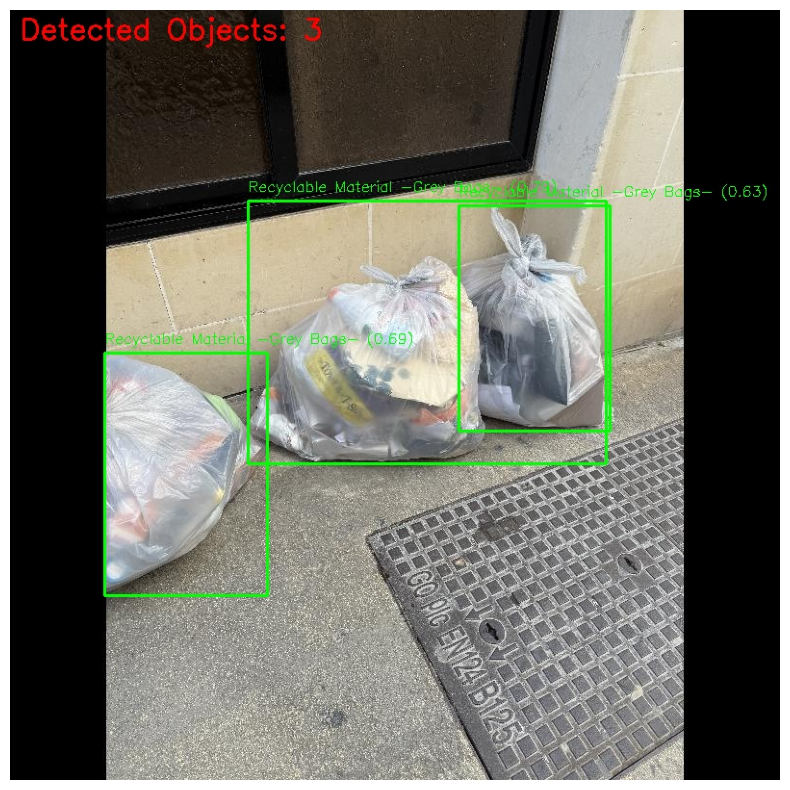

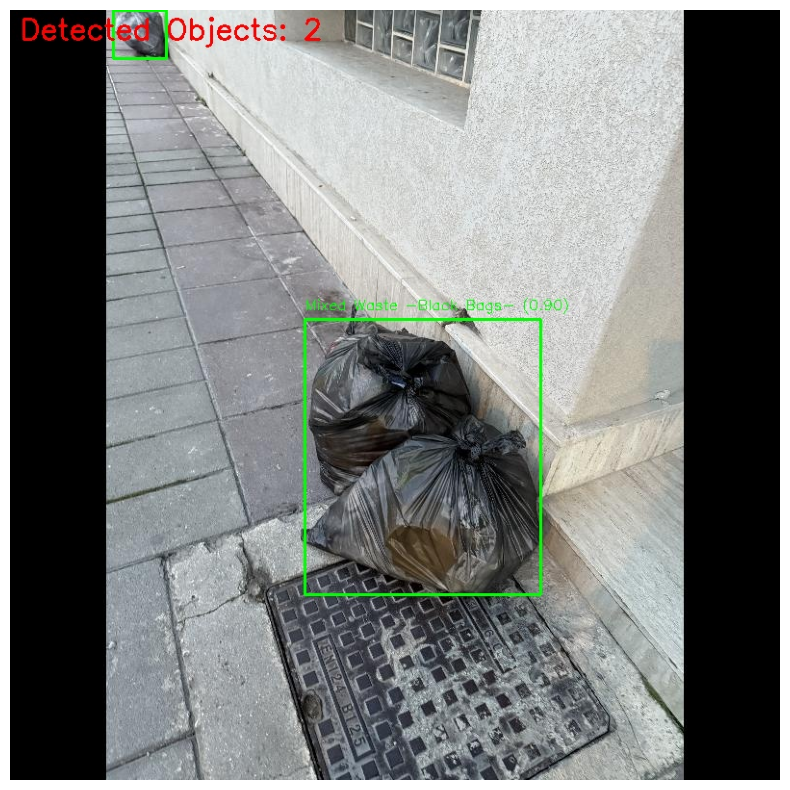

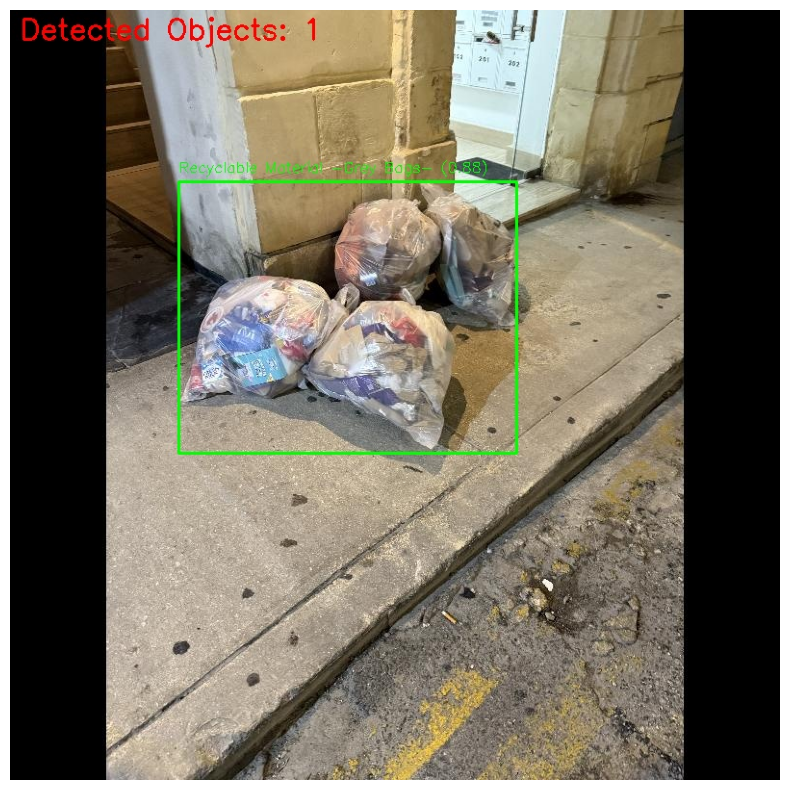

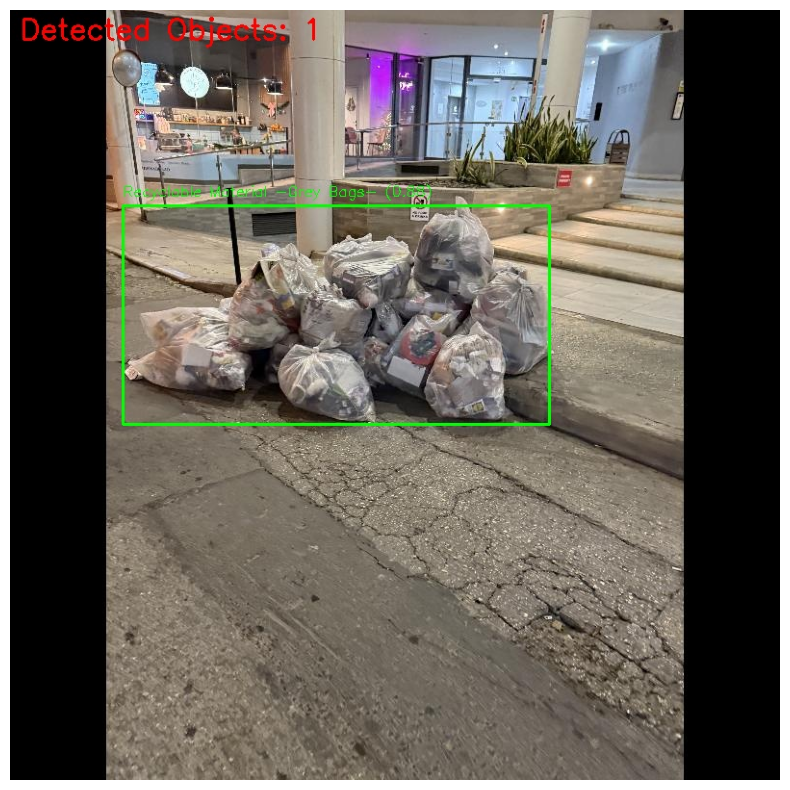

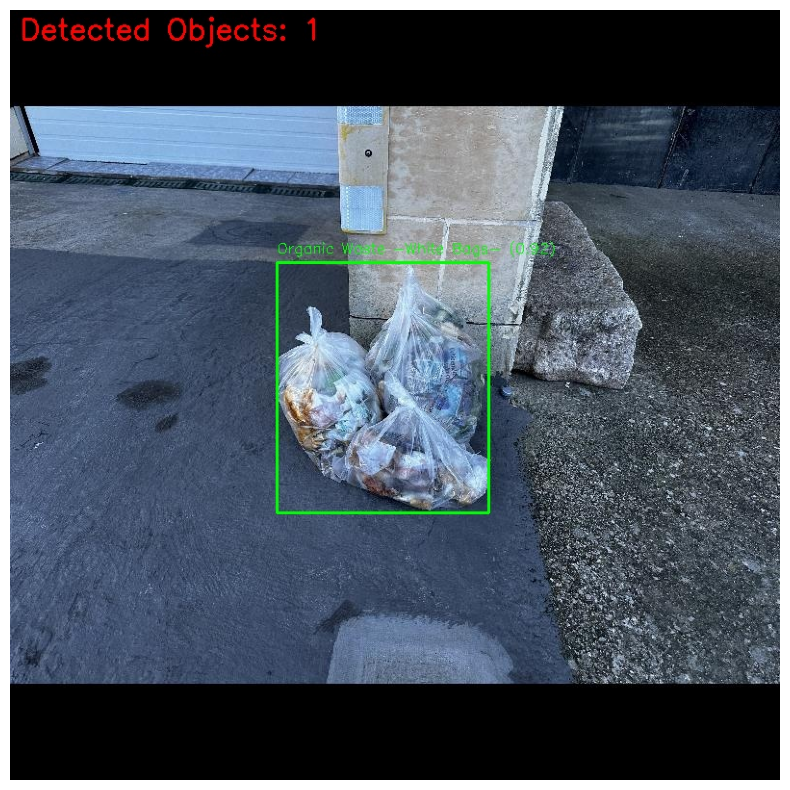

...

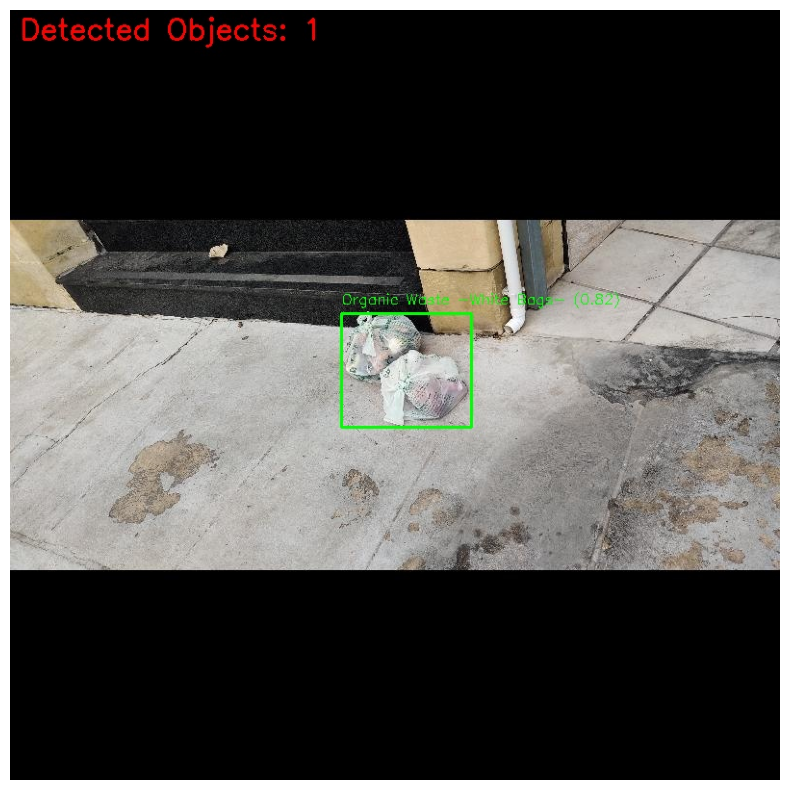

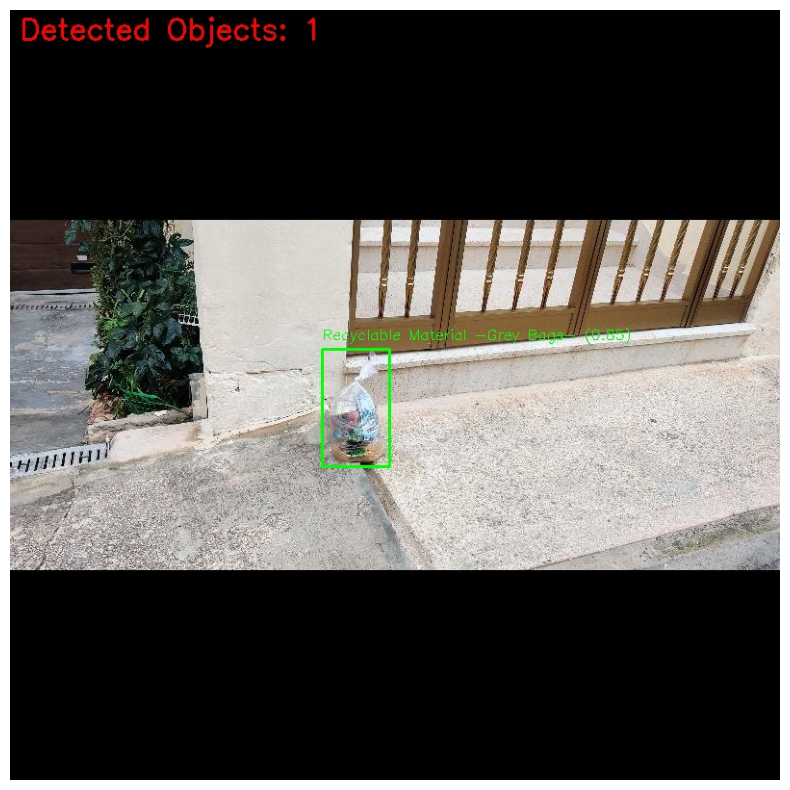

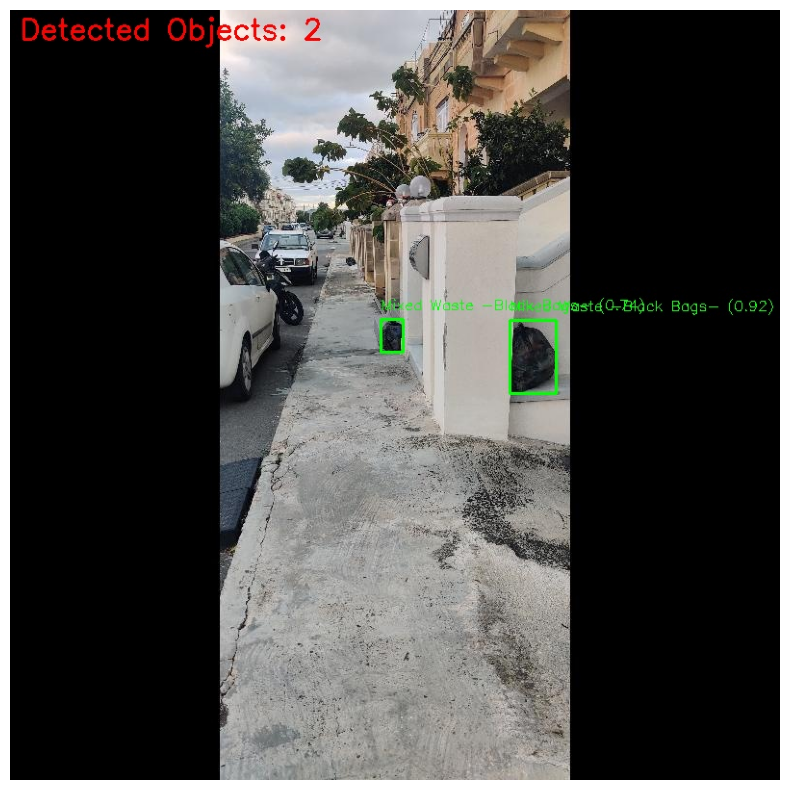

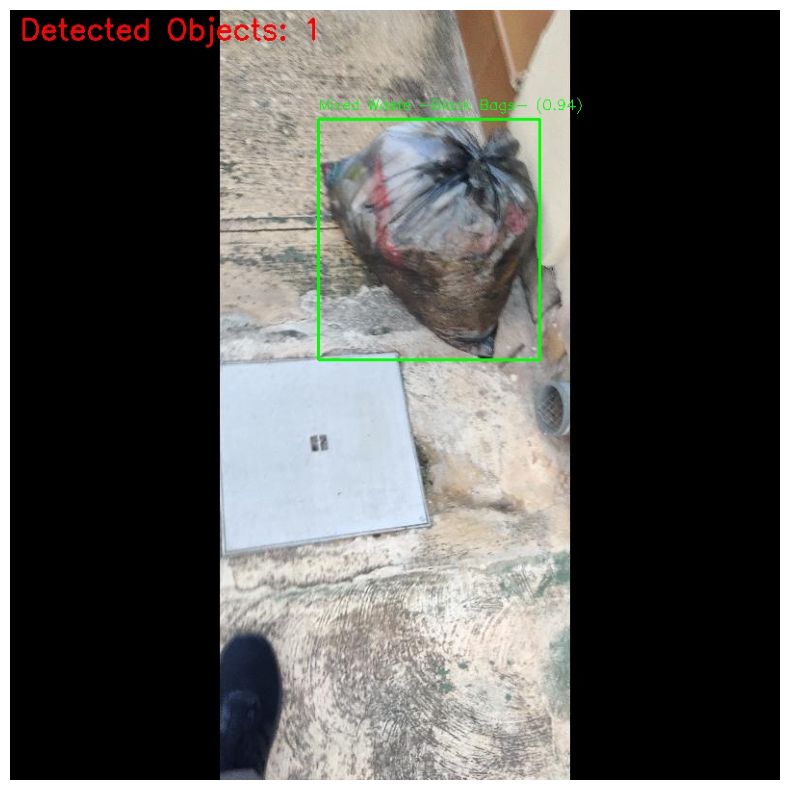

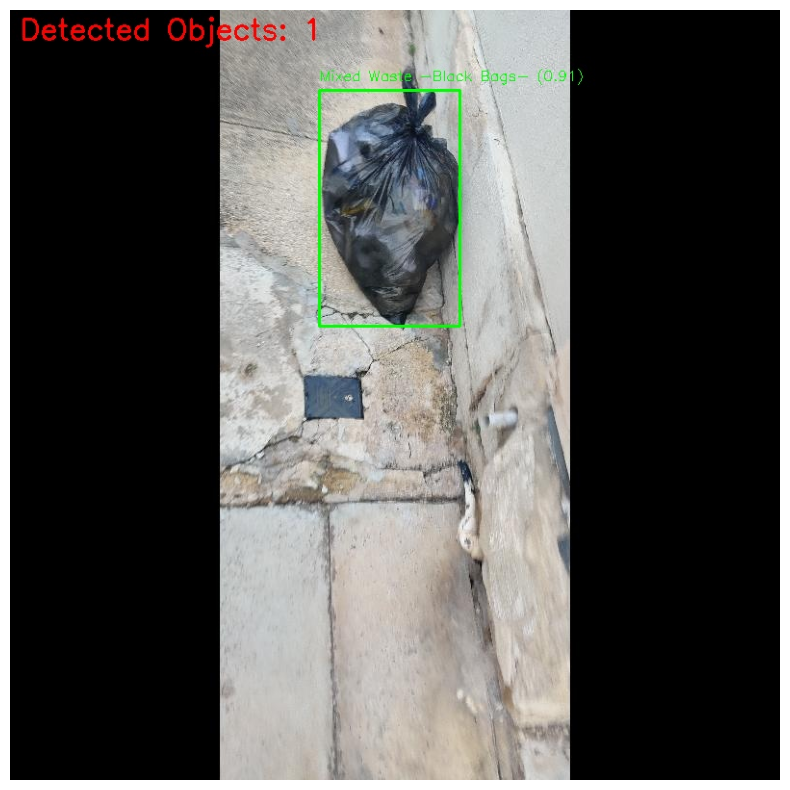

In [39]:
for img in os.listdir(output_dir):
    img = plt.imread(os.path.join(output_dir, img))
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()